In [21]:
import cv2
import numpy as np
import sys

import torch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data

import matplotlib.pyplot as plt

sys.path.append('/home/meribejayson/Desktop/Projects/SharkCNN/training_models/dataloaders/')

megaset_test_images_path = "/home/meribejayson/Desktop/Projects/SharkCNN/datasets-reduced/megaset/test/images/"

from get_single_image_test_features import SharkImageFeatureGen as FeatureGenerator

In [22]:
image_name = "dji360-104.jpg"
# image_name = "dji255-175.jpg"

feature_gen = FeatureGenerator()
features = feature_gen.generate_image_features(image_name)

In [23]:
torch.manual_seed(12)

if not torch.cuda.is_available():
    raise Exception("Couldn't find CUDA")

device = torch.device("cuda")

In [24]:
class LogisticRegresion(nn.Module):

    def __init__(self, input_size):
        super().__init__()
        
        self.linear = nn.Linear(input_size,1)
        self.sig = nn.Sigmoid()

    def forward(self, x):
        x = self.linear(x)
        
        return self.sig(x)

In [25]:
class ANN(nn.Module):

    def __init__(self, input_size):
        super().__init__()
        
        hidden_layer_num = int(input_size / 2)

        self.linear1 = nn.Linear(input_size, hidden_layer_num)
        self.relu1 = nn.ReLU()
        self.linear2 = nn.Linear(hidden_layer_num + input_size, 1)
        self.sig = nn.Sigmoid()
        

    def forward(self, x):
        h = self.linear1(x)
        h = self.relu1(h)
        h = torch.cat((x, h), dim=1)
        h = self.linear2(h)
        
        return self.sig(h)

In [26]:
ann_state = torch.load("/home/meribejayson/Desktop/Projects/SharkCNN/training_models/ANN/train-4/ann_weights_train_4.tar")
lr_state = torch.load("/home/meribejayson/Desktop/Projects/SharkCNN/training_models/LOGISTIC-REG/train-final-6/lr_weights_train_6.tar")

ann_model = ANN(85)
ann_model.load_state_dict(ann_state)
ann_model.to(device)


lr_model = LogisticRegresion(85)
lr_model.load_state_dict(lr_state)
lr_model.to(device)

LogisticRegresion(
  (linear): Linear(in_features=85, out_features=1, bias=True)
  (sig): Sigmoid()
)

In [27]:
data_inputs = features[:, :-1].to(device).float()
data_labels = features[:, -1].to(device).float()

labels = data_labels.to('cpu').numpy().astype(int).flatten()

with torch.no_grad():
    ann_preds = ann_model(data_inputs).to('cpu').numpy().flatten()
    lr_preds = lr_model(data_inputs).to('cpu').numpy().flatten()

In [28]:
image = cv2.imread(megaset_test_images_path + image_name)

image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
overlay_lr = image.copy()
overlay_ann = image.copy()

for y in range(image.shape[0]):
    for x in range(image.shape[1]):
        curr_idx = (1920 * y) + x

        if ann_preds[curr_idx] > 0.5:
            overlay_ann[y, x] = [255, 0, 0]

        if lr_preds[curr_idx] > 0.5:
            overlay_lr[y, x] = [255, 0, 0]



alpha = 0.25 
output_image_ann = cv2.addWeighted(image_rgb, 1 - alpha, cv2.cvtColor(overlay_ann, cv2.COLOR_BGR2RGB), alpha, 0)
output_image_lr = cv2.addWeighted(image_rgb, 1 - alpha, cv2.cvtColor(overlay_lr, cv2.COLOR_BGR2RGB), alpha, 0)

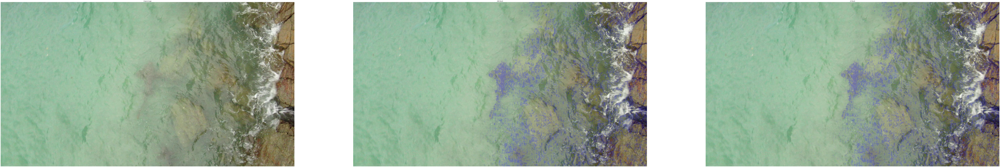

In [29]:
# Display the original and the output image
plt.figure(figsize=(200, 100))
plt.subplot(1, 3, 1)
plt.axis('off')
plt.imshow(image_rgb)
plt.title('Original Image')

plt.subplot(1, 3, 2)
plt.axis('off')
plt.imshow(output_image_ann)
plt.title('ANN Result')

plt.subplot(1, 3, 3)
plt.axis('off')
plt.imshow(output_image_ann)
plt.title('LR Result')

plt.show()


<Figure size 640x480 with 0 Axes>

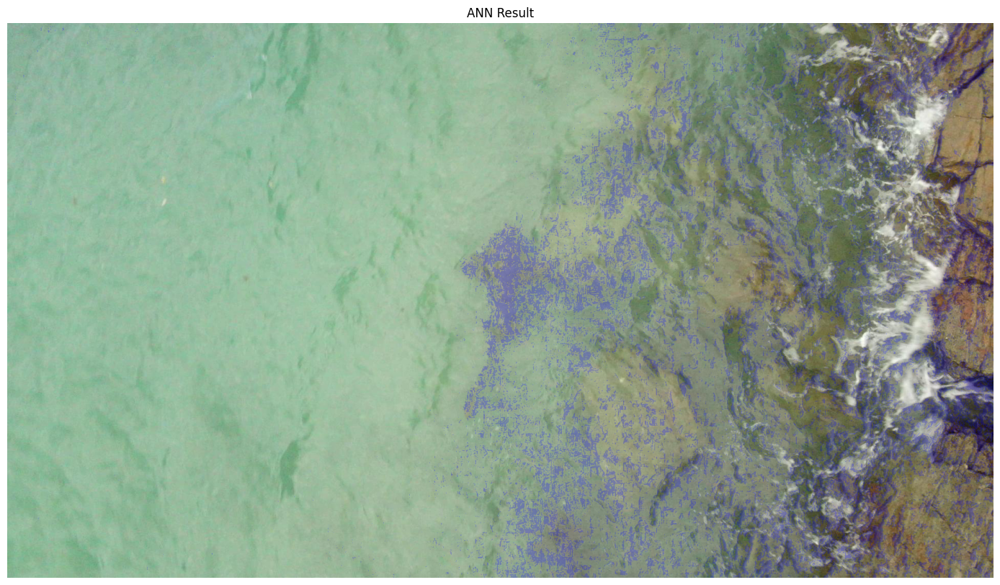

In [30]:
plt.clf()
plt.figure(figsize=(20, 10))
plt.axis('off')
plt.imshow(output_image_ann)
plt.title('ANN Result')
plt.savefig('./ann_result_test_2.png')